In [59]:
#Collect the dates and hours of the event into two lists
dates = ['20220725','20220726','20220727','20220728','20220729','20220730','20220731']
hours = ['0000','0600','1200','1800']

#Store the website to take data from inside a variable
url_root = "https://www.ncei.noaa.gov/data/rapid-refresh/access/rap-130-13km/analysis/"

#Combine the lists and website variable into one list to pull the correct files
files_to_download = [url_root + date[0:6] + '/' + date + '/' + 'rap_130_' + date + '_' + hour + '_000.grb2' for date in dates for hour in hours]

#Use for loop to download files from internet
for file in files_to_download:
    #!wget $file
    !curl -# -O $file
    print(file)

######################################################################### 100.0%
https://www.ncei.noaa.gov/data/rapid-refresh/access/rap-130-13km/analysis/202207/20220725/rap_130_20220725_0000_000.grb2
######################################################################### 100.0%
https://www.ncei.noaa.gov/data/rapid-refresh/access/rap-130-13km/analysis/202207/20220725/rap_130_20220725_0600_000.grb2
######################################################################### 100.0%
https://www.ncei.noaa.gov/data/rapid-refresh/access/rap-130-13km/analysis/202207/20220725/rap_130_20220725_1200_000.grb2
######################################################################### 100.0%
https://www.ncei.noaa.gov/data/rapid-refresh/access/rap-130-13km/analysis/202207/20220725/rap_130_20220725_1800_000.grb2
######################################################################### 100.0%
https://www.ncei.noaa.gov/data/rapid-refresh/access/rap-130-13km/analysis/202207/20220726/rap_130_20220726_0000

/var/folders/k5/9pfttj9d3fq6g8b3g_td2z848n6svb/T/ipykernel_92301/1836819537.py:379: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(14,12))


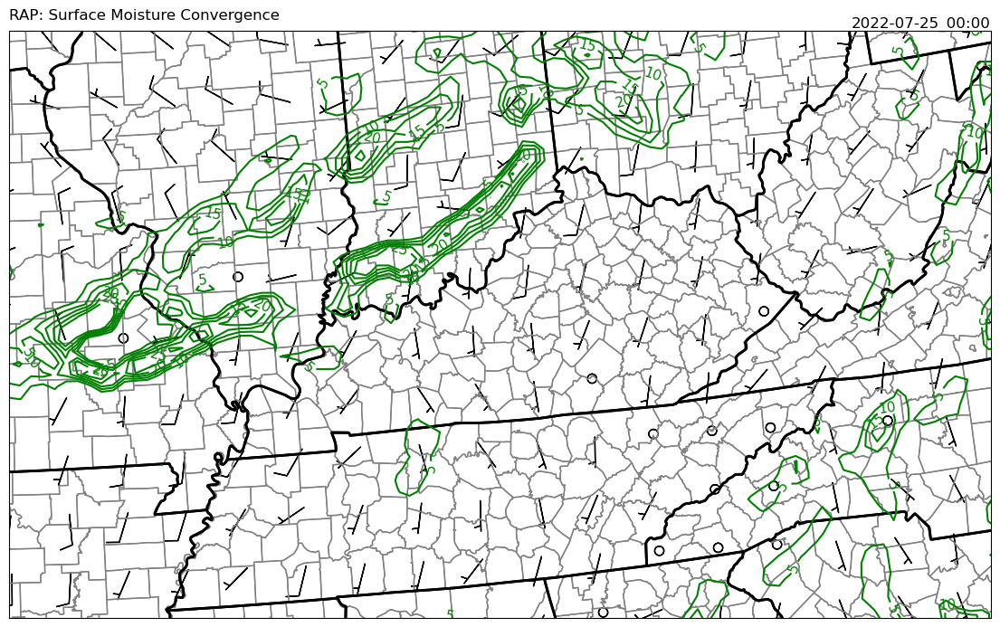

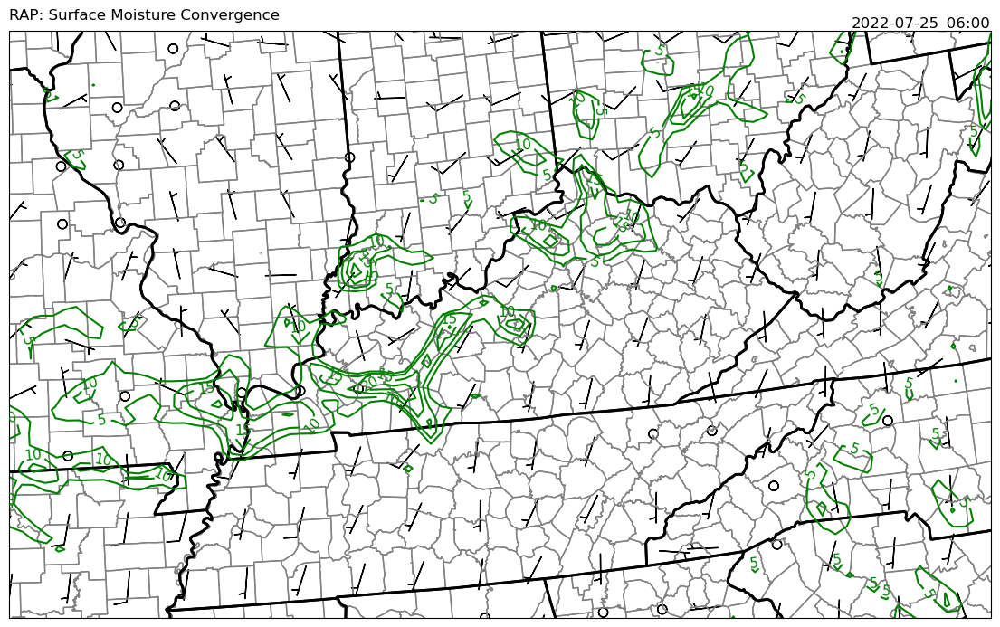

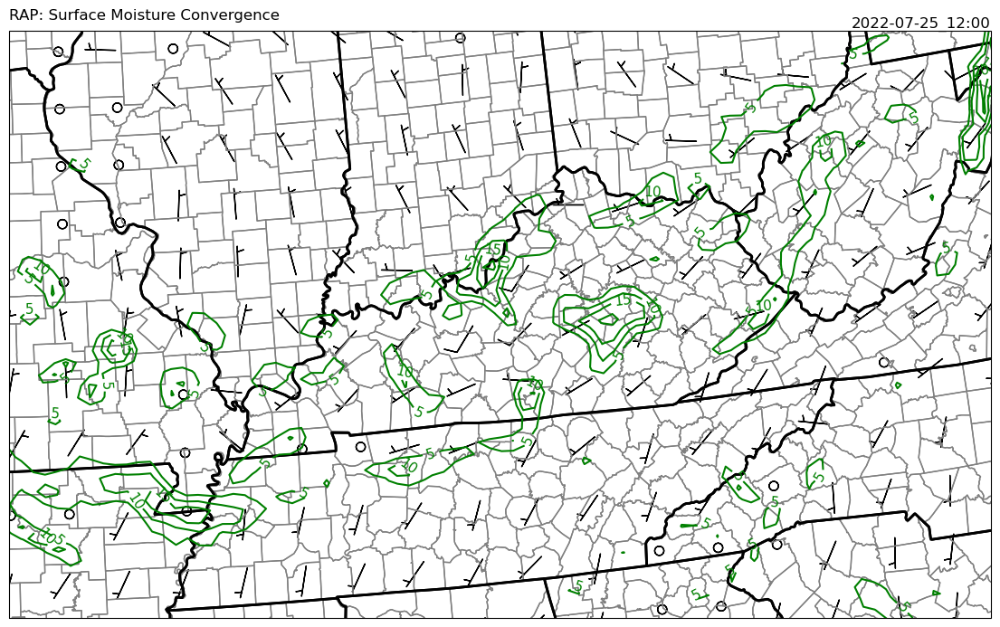

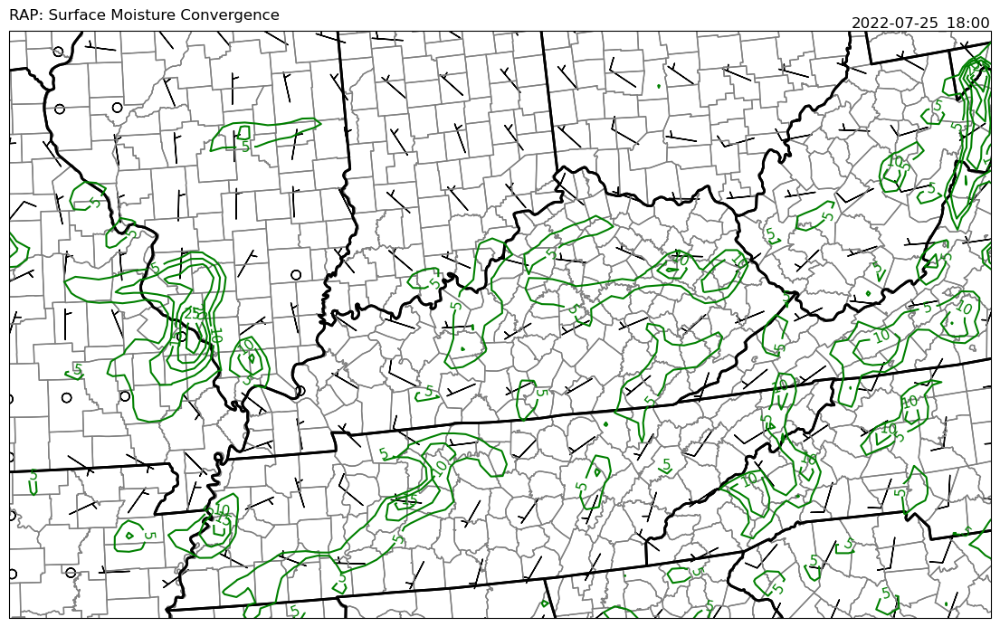

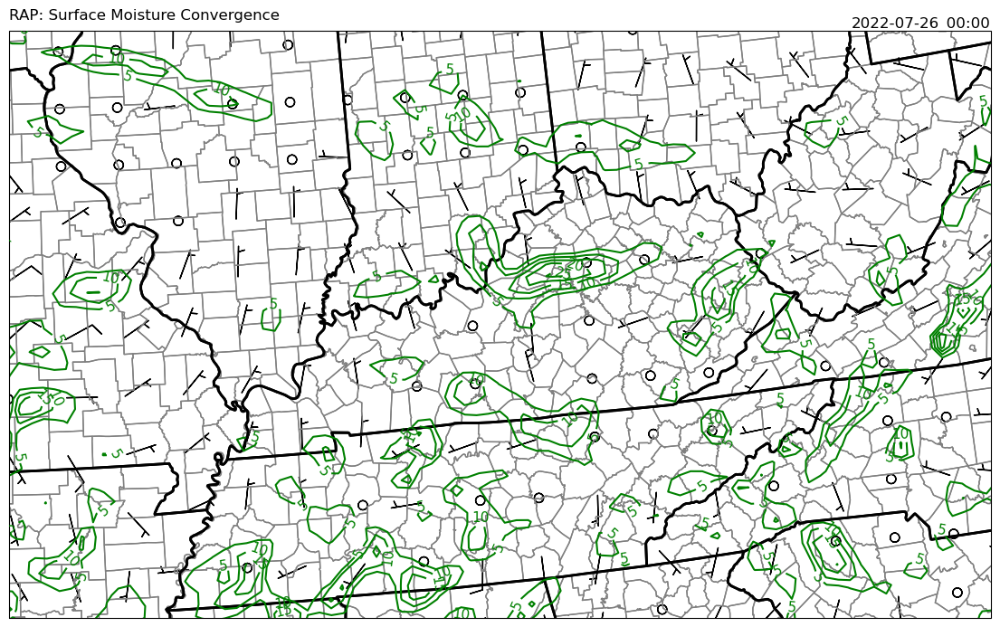

...

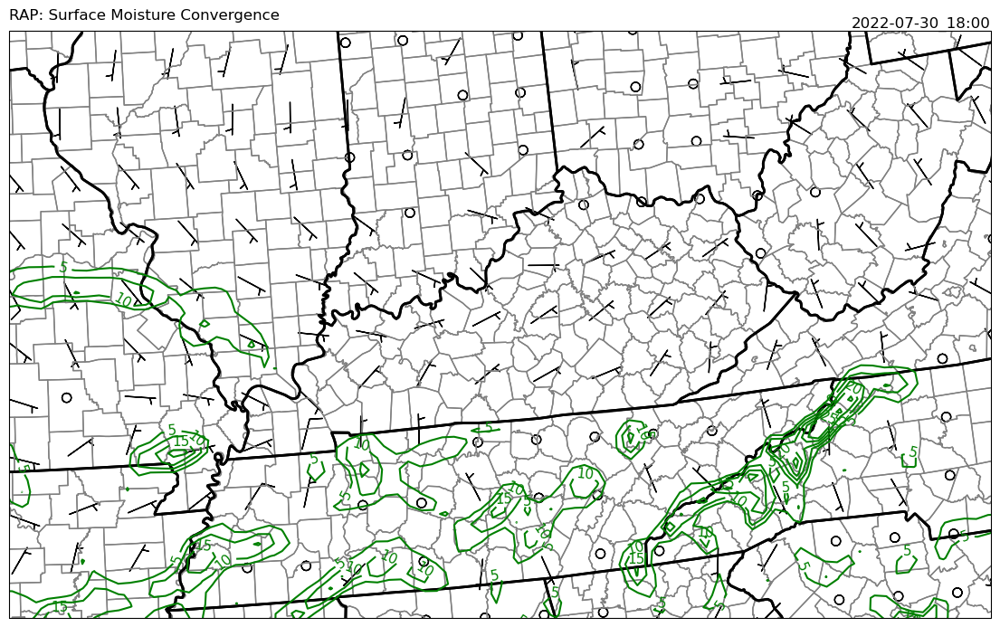

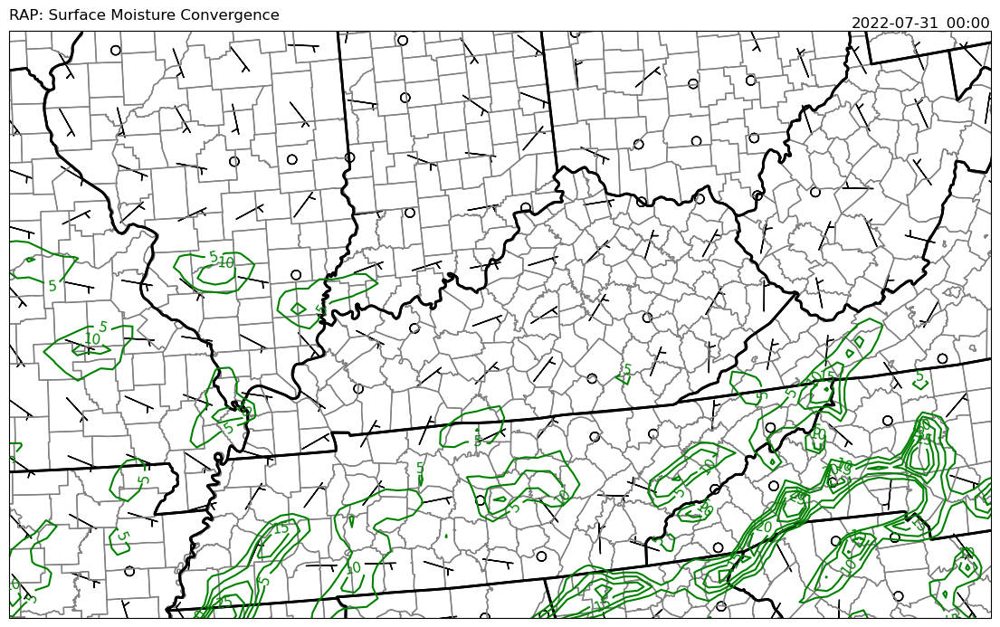

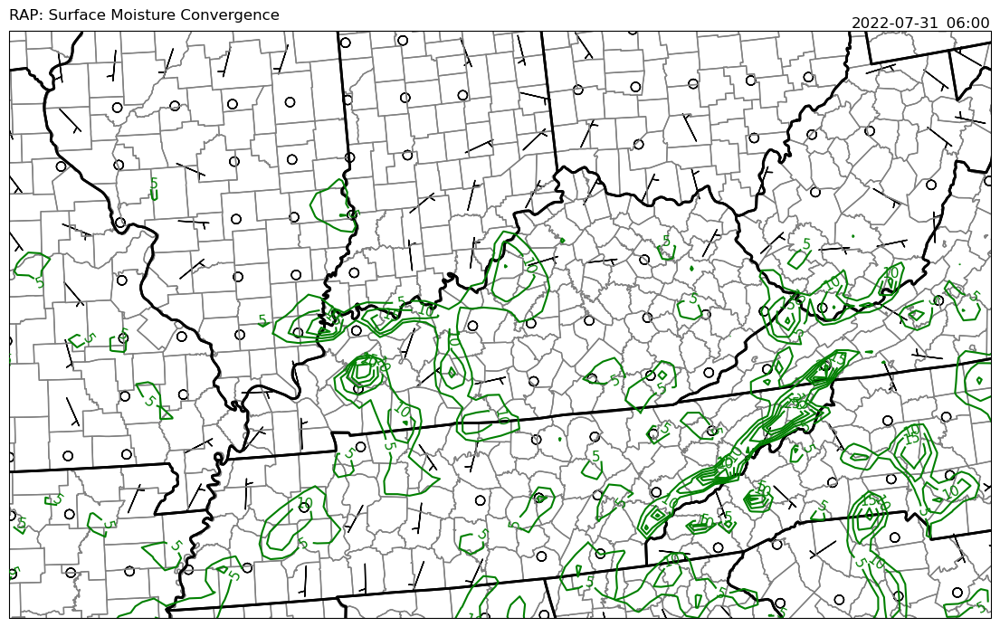

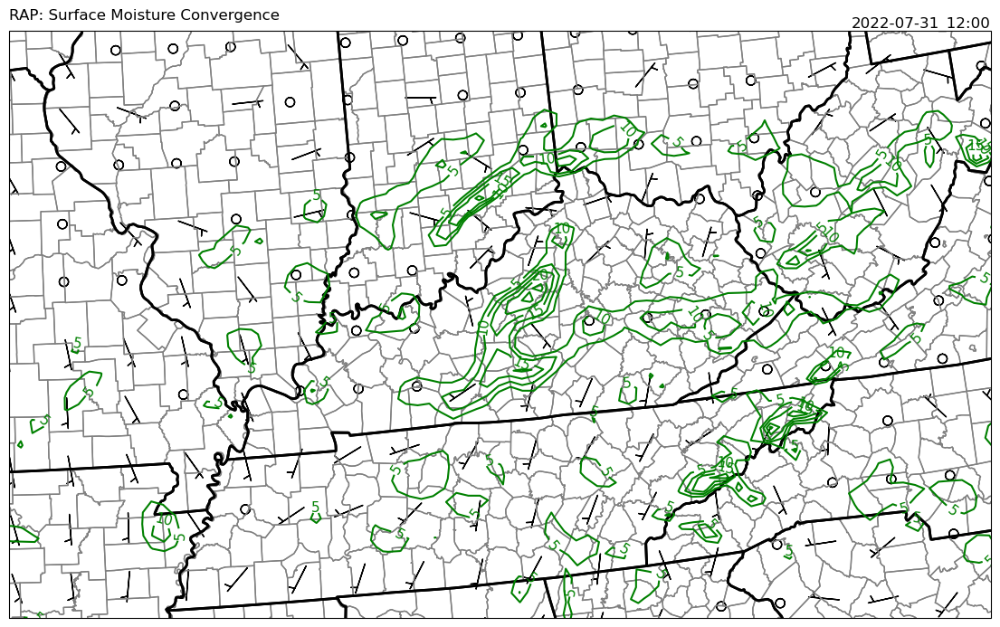

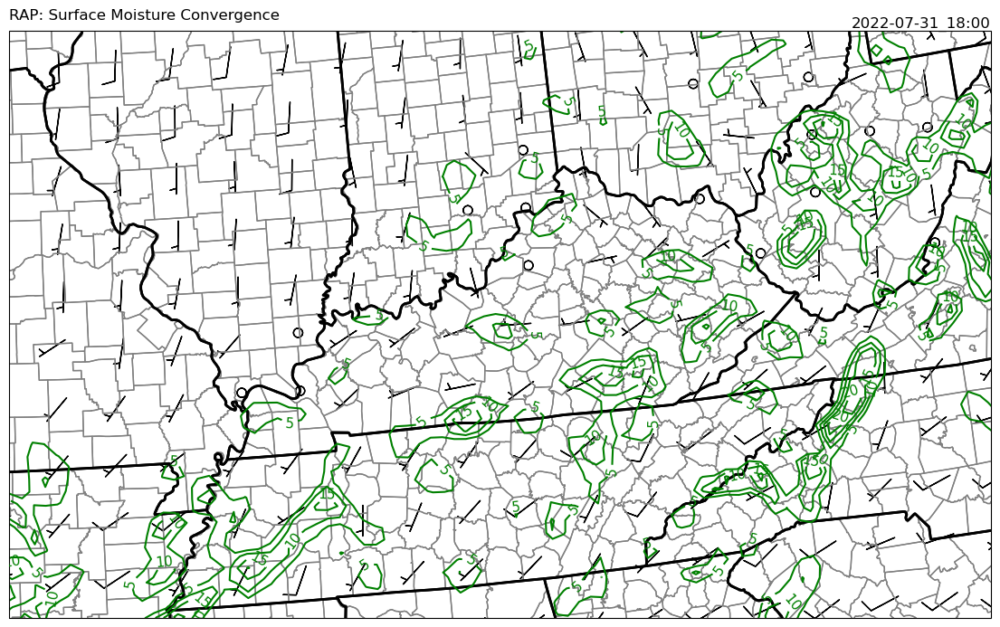

In [2]:
#Import all necessary python libraries
import Nio
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
from matplotlib.colors import Normalize
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from datetime import datetime, timedelta
from glob import glob
from metpy.units import units
import metpy.calc as metcalc
from metpy.plots import ctables
from metpy.plots import USCOUNTIES
from scipy.ndimage import gaussian_filter
from scipy.ndimage import minimum_filter, maximum_filter

#Sort all files by date
path = './'
files = sorted(glob(path+'rap_130_2022*.grb2'))

f = Nio.open_file(files[0])

nx = f.dimensions['xgrid_0']                   # dimensions
ny = f.dimensions['ygrid_0']
npres = f.dimensions['lv_ISBL0']

lats=f.variables['gridlat_0'].get_value()      # coordinates
lons=f.variables['gridlon_0'].get_value()
rot =f.variables['gridrot_0'].get_value()
pres=f.variables['lv_ISBL0'].get_value()
hght=f.variables['lv_HTGL3'].get_value()

#print(f.variables['POT_P0_L103_GLC0'].get_value())
#print(f)

#Define the projections used
map_proj = ccrs.LambertConformal()
data_proj = ccrs.PlateCarree()

'''
VUCSH_P0_2L103_GLC0
VVCSH_P0_2L103_GLC0
#Grab the NWS Reflectivity color table
cmap = ctables.registry.get_colortable('NWSReflectivity')
'''

#Map code for PWAT
def pwatt(file):
    #Open the file
    f = Nio.open_file(file)
    
    #Pull the time from a variable
    tinit=f.variables['TMP_P0_L1_GLC0'].attributes['initial_time']
    time = datetime.strptime(tinit, '%m/%d/%Y (%H:%M)')
    
    #Double check that the time is pulled correctly
    filenm_time = datetime.strptime(file[10:23], '%Y%m%d_%H%M')
    if filenm_time != time:
        sys.exit(-1, 'file time problem, stopped')
    
    #Grab the needed variables for the mesocale variable
    pwat = f.variables['PWAT_P0_L200_GLC0'].get_value()
    
    #Smooth pwat
    pwat = gaussian_filter(pwat, sigma=3)
    
    #Define PWAT as mm then convert to inches
    pwat = units.Quantity(pwat, "mm")
    pwat.ito('inch')
    
    #Define figure for display and add subplot
    fig = plt.figure(figsize=(14,12))
    ax = fig.add_subplot(111,projection=map_proj)
    
    #Set extent of the map to just Ohio River Valley(ish)
    ax.set_extent([-92,-80,35,40])
    
    #Add map features
    ax.add_feature(USCOUNTIES.with_scale('5m'), edgecolor='gray')
    ax.add_feature(cfeature.STATES, edgecolor='black',lw=2)
    
    #Plot pwat with contour and filled contour
    pwatts = ax.contour(lons,lats,pwat,levels=np.arange(0.0,3.1,0.1),transform=data_proj,colors='k',alpha=0.8)
    pwattf = ax.contourf(lons,lats,pwat,levels=np.arange(1.0,3.5,0.5),transform=data_proj,cmap='Greens',alpha=0.8)
    plt.clabel(pwatts,fontsize=11,inline=True,fmt='%.1f',rightside_up=True)
    
    #create colorbar for precipitable water
    watCB = plt.colorbar(pwattf,shrink=0.6,pad=0.05)
    watCB.set_label(r'Precipitable Water (in)')
    
    #Create map title
    ax.set_title('RAP: Precipitable Water Entire Atmosphere',loc='left')
    ax.set_title(time.strftime('%Y-%m-%d_%H:%M'), transform=ax.transAxes,loc='right')
    
    #Save the image to the correct folder
    relPath = 'Desktop/pwatt/'
    outfile = 'RAP_pwatt_{:s}.png'.format(time.strftime('%Y%m%d_%H%M'))
    plt.savefig(relPath+outfile, bbox_inches='tight', pad_inches=0.1) 
    
    #Close the file
    f.close

#Map Code for SBCAPE and SBCIN
def capecn(file):
    #Open the file
    f = Nio.open_file(file)
    
    #Pull the time from a variable
    tinit=f.variables['TMP_P0_L1_GLC0'].attributes['initial_time']
    time = datetime.strptime(tinit, '%m/%d/%Y (%H:%M)')
    
    #Double check that the time is pulled correctly
    filenm_time = datetime.strptime(file[10:23], '%Y%m%d_%H%M')
    if filenm_time != time:
        sys.exit(-1, 'file time problem, stopped')
    
    #Grab the needed variables for the mesocale variable
    cape = f.variables['CAPE_P0_L1_GLC0'].get_value()
    cinf = f.variables['CIN_P0_L1_GLC0'].get_value()*-1
    
    #smooth cape and cinf
    cape = gaussian_filter(cape, sigma=3)
    cinf = gaussian_filter(cinf, sigma=3)
    
    #Define figure for display and add subplot
    fig = plt.figure(figsize=(14,12))
    ax = fig.add_subplot(111,projection=map_proj)
    
    #Set extent of the map to just Ohio River Valley(ish)
    ax.set_extent([-92,-80,35,40])
    
    #Add map features
    ax.add_feature(USCOUNTIES.with_scale('5m'), edgecolor='gray')
    ax.add_feature(cfeature.STATES, edgecolor='black',lw=2)
    
    #Plot cape and cin
    sbcape = ax.contour(lons,lats,cape,levels=np.arange(1000,4001,500),transform=data_proj,colors='r',alpha=0.8)
    sbcin = ax.contourf(lons,lats,cinf,levels=np.arange(25,226,25),transform=data_proj,cmap='cool',alpha=0.8)
    plt.clabel(sbcape,fontsize=11,inline=True,fmt='%i',rightside_up=True)
    
    #create colorbar for convective inhibition
    cinCB = plt.colorbar(sbcin,shrink=0.6,pad=0.05)
    cinCB.set_label(r'Convective Inhibition (J/kg)')
    
    #Create map title
    ax.set_title('RAP: SBCAPE and SBCIN',loc='left')
    ax.set_title(time.strftime('%Y-%m-%d_%H:%M'), transform=ax.transAxes,loc='right')
    
    #Save the image to the correct folder
    relPath = 'Desktop/cape/'
    outfile = 'RAP_capecin_{:s}.png'.format(time.strftime('%Y%m%d_%H%M'))
    plt.savefig(relPath+outfile, bbox_inches='tight', pad_inches=0.1) 
    
    #Close the file
    f.close

#Map code for Wind Shear    
def wndsh(file):
    #Define the pressure variables
    lvlSfc = 100000 #Relative surfce pressure
    lvl500 = 50000  #Roughly 6 km up
    
    paSfc = np.where(pres==lvlSfc)[0][0]
    pa500 = np.where(pres==lvl500)[0][0]
    
    #Open the file
    f = Nio.open_file(file)
    
    #Pull the time from a variable
    tinit=f.variables['TMP_P0_L1_GLC0'].attributes['initial_time']
    time = datetime.strptime(tinit, '%m/%d/%Y (%H:%M)')
    
    #Double check that the time is pulled correctly
    filenm_time = datetime.strptime(file[10:23], '%Y%m%d_%H%M')
    if filenm_time != time:
        sys.exit(-1, 'file time problem, stopped')
    
    #Grab wind variables
    Usfc = f.variables['UGRD_P0_L100_GLC0'].get_value()[paSfc,:,:]* 1.944 #Convert to knots
    Vsfc = f.variables['VGRD_P0_L100_GLC0'].get_value()[paSfc,:,:]* 1.944 #Convert to knots
    
    U500 = f.variables['UGRD_P0_L100_GLC0'].get_value()[pa500,:,:]* 1.944 #Convert to knots
    V500 = f.variables['VGRD_P0_L100_GLC0'].get_value()[pa500,:,:]* 1.944 #Convert to knots
    
    #Calculate Wind Shear
    USHR = U500 - Usfc
    VSHR = V500 - Vsfc
    
    #Change wind to account for rotation
    UE = np.sin(rot)*VSHR + np.cos(rot)*USHR
    VE = np.cos(rot)*VSHR - np.sin(rot)*USHR
    
    #Find bulk wind shear
    wshr = np.hypot(UE,VE)
    
    #Smooth WSHR
    wshr = gaussian_filter(wshr,sigma=2)
    
    # Lat, lon, UE, VE for wshr>=30:
    mask = wshr<30
    lons30 = np.ma.masked_where(mask, lons)
    lats30 = np.ma.masked_where(mask, lats)
    UE30   = np.ma.masked_where(mask, UE)
    VE30   = np.ma.masked_where(mask, VE) 
    
    #Define figure for display and add subplot
    fig = plt.figure(figsize=(14,12))
    ax = fig.add_subplot(111,projection=map_proj)
    
    #Set extent of the map to just Ohio River Valley(ish)
    ax.set_extent([-92,-80,35,40])
    
    #Add map features
    ax.add_feature(USCOUNTIES.with_scale('5m'), edgecolor='gray')
    ax.add_feature(cfeature.STATES, edgecolor='black',lw=2)
    
    #Define skip variable
    s = 5
    
    #Plot Wind shear
    wndshr = ax.contour(lons,lats,wshr,levels=range(30,71,10),transform=data_proj,cmap='cool')
    plt.clabel(wndshr,fontsize=11,inline=True,fmt='%i',rightside_up=True)
    
    ax.barbs(lons30[::s,::s], lats30[::s,::s],UE30[::s,::s],VE30[::s,::s],transform=data_proj,lw=1,color='b')
    
    #Create map title
    ax.set_title('RAP: Sfc-6km Wind Shear (kts)',loc='left')
    ax.set_title(time.strftime('%Y-%m-%d_%H:%M'), transform=ax.transAxes,loc='right')
    
    #Save the image to the correct folder
    relPath = 'Desktop/shear/'
    outfile = 'RAP_windshear_{:s}.png'.format(time.strftime('%Y%m%d_%H%M'))
    plt.savefig(relPath+outfile, bbox_inches='tight', pad_inches=0.1) 
    
    #Close the file
    f.close
    
def frtngn(file):
    #Define height level above ground (m) and pull that data
    lvl10 = 10
    
    hgt10 = np.where(hght==lvl10)[0][0]
    
    #Open the file
    f = Nio.open_file(file)
    
    #Pull the time from a variable
    tinit=f.variables['TMP_P0_L1_GLC0'].attributes['initial_time']
    time = datetime.strptime(tinit, '%m/%d/%Y (%H:%M)')
    
    #Double check that the time is pulled correctly
    filenm_time = datetime.strptime(file[10:23], '%Y%m%d_%H%M')
    if filenm_time != time:
        sys.exit(-1, 'file time problem, stopped')
        
    #Grab wind variables and surface temperature and pressure
    U10 = f.variables['UGRD_P0_L103_GLC0'].get_value()[hgt10,:,:]
    V10 = f.variables['VGRD_P0_L103_GLC0'].get_value()[hgt10,:,:]
    
    pott = f.variables['POT_P0_L103_GLC0'].get_value()
    mslp = f.variables['MSLMA_P0_L101_GLC0'].get_value() / 100 #Convert to mb
    temp = f.variables['TMP_P0_L1_GLC0'].get_value()
    
    #Change wind to account for rotation
    UE = np.sin(rot)*V10 + np.cos(rot)*U10
    VE = np.cos(rot)*V10 - np.sin(rot)*U10
    
    #Define dx and dy.
    dx, dy = 13.545, 13.545
    
    dx = units.Quantity(dx,"km")
    dy = units.Quantity(dy,"km")
    dx.ito('m')
    dy.ito('m')
    
    #Quatify the variables for use in metpy calculations
    UE = units.Quantity(UE,"m/s")
    VE = units.Quantity(VE,"m/s")
    
    pott = units.Quantity(pott,"kelvin")
    temp = units.Quantity(temp-273.15, "degC")
    mslp = units.Quantity(mslp, "mbar")
                         
    #Calculate Potential temperature and frontogenesis
    frnt = metcalc.frontogenesis(pott,UE,VE,dx=dx,dy=dy)*1.08e9
    
    #Smooth temp and frnt
    temp = gaussian_filter(temp,sigma=2)
    frnt = gaussian_filter(frnt,sigma=2)
    
    #Define figure for display and add subplot
    fig = plt.figure(figsize=(14,12))
    ax = fig.add_subplot(111,projection=map_proj)
    
    #Set extent of the map to just Ohio River Valley(ish)
    ax.set_extent([-92,-80,35,40])
    
    #Add map features
    ax.add_feature(USCOUNTIES.with_scale('5m'), edgecolor='gray')
    ax.add_feature(cfeature.STATES, edgecolor='black',lw=2)
    
    #Define skip variable
    s = 5
    
    #Plot frontogenesis, temp, pressure, and wind barbs
    sfcp = ax.contour(lons,lats,mslp,levels=range(960,1042,4),transform=data_proj,colors='k')
    plt.clabel(sfcp,fontsize=11,inline=True,fmt='%i',rightside_up=True)
    
    sfcf = ax.contour(lons,lats,frnt,levels=range(1,6,1),transform=data_proj,colors='purple')
    plt.clabel(sfcf,fontsize=11,inline=True,fmt='%i',rightside_up=True)
    
    sfct = ax.contour(lons,lats,temp,levels=range(10,37,2),transform=data_proj,colors='r',linestyles=':')
    plt.clabel(sfct,fontsize=11,inline=True,fmt='%i',rightside_up=True)
    
    ax.barbs(lons[::s,::s], lats[::s,::s],UE[::s,::s],VE[::s,::s],transform=data_proj,lw=1,color='k')
    
    #Create map title
    ax.set_title('RAP: Surface Frontogenesis',loc='left')
    ax.set_title(time.strftime('%Y-%m-%d_%H:%M'), transform=ax.transAxes,loc='right')
    
    #Save the image to the correct folder
    relPath = 'Desktop/front/'
    outfile = 'RAP_frontogenesis_{:s}.png'.format(time.strftime('%Y%m%d_%H%M'))
    plt.savefig(relPath+outfile, bbox_inches='tight', pad_inches=0.1) 
    
    #Close the file
    f.close
    
def mstconv(file):
    #Define the pressure variables
    lvl10 = 10
    
    hgt10 = np.where(hght==lvl10)[0][0]
    
    #Open the file
    f = Nio.open_file(file)
    
    #Pull the time from a variable
    tinit=f.variables['TMP_P0_L1_GLC0'].attributes['initial_time']
    time = datetime.strptime(tinit, '%m/%d/%Y (%H:%M)')
    
    #Double check that the time is pulled correctly
    filenm_time = datetime.strptime(file[10:23], '%Y%m%d_%H%M')
    if filenm_time != time:
        sys.exit(-1, 'file time problem, stopped')
        
    #Relative Humidity
    relh = f.variables['RH_P0_L4_GLC0'].get_value()
    
    #Grab wind variables and surface temperature and pressure
    U10 = f.variables['UGRD_P0_L103_GLC0'].get_value()[hgt10,:,:]* 1.944 #Convert to knots
    V10 = f.variables['VGRD_P0_L103_GLC0'].get_value()[hgt10,:,:]* 1.944 #Convert to knots
    
    #Change wind to account for rotation
    UE = np.sin(rot)*V10 + np.cos(rot)*U10
    VE = np.cos(rot)*V10 - np.sin(rot)*U10
    
    #Calculate the moisture convergence
    UQ = UE*relh
    VQ = VE*relh  
    
    #Define dx and dy.
    dx, dy = 13.545, 13.545
    
    dx = units.Quantity(dx,"km")
    dy = units.Quantity(dy,"km")
    
    #Calculate divergancve
    mcnv = metcalc.divergence(UQ,VQ,dx=dx,dy=dy)*-1
    
    #Smooth temp and frnt
    #mcnv = gaussian_filter(mcnv,sigma=3)
    
    
    #Define figure for display and add subplot
    fig = plt.figure(figsize=(14,12))
    ax = fig.add_subplot(111,projection=map_proj)
    
    #Set extent of the map to just Ohio River Valley(ish)
    ax.set_extent([-92,-80,35,40])
    
    #Add map features
    ax.add_feature(USCOUNTIES.with_scale('5m'), edgecolor='gray')
    ax.add_feature(cfeature.STATES, edgecolor='black',lw=2)
    
    #Define skip variable
    s = 5
    
    moistcv = ax.contour(lons,lats,mcnv,levels=range(5,30,5),transform=data_proj,colors='g')
    plt.clabel(moistcv,fontsize=11,inline=True,fmt='%i',rightside_up=True)
    
    ax.barbs(lons[::s,::s], lats[::s,::s],UE[::s,::s],VE[::s,::s],transform=data_proj,lw=1,color='k')
    
    #Create map title
    ax.set_title('RAP: Surface Moisture Convergence',loc='left')
    ax.set_title(time.strftime('%Y-%m-%d_%H:%M'), transform=ax.transAxes,loc='right')
    
    #Save the image to the correct folder
    relPath = 'Desktop/conv/'
    outfile = 'RAP_mstconv_{:s}.png'.format(time.strftime('%Y%m%d_%H%M'))
    plt.savefig(relPath+outfile, bbox_inches='tight', pad_inches=0.1) 
    
    #Close the file
    f.close

for file in files:
    #pwatt(file)
    #capecn(file)
    #wndsh(file)
    #frtngn(file)
    mstconv(file)